In [1]:
import sklearn  
import scipy  
import numpy as np  
import random  
import pandas as pd
from nltk.corpus import stopwords
from scipy.sparse import csr_matrix  
from sklearn.model_selection import train_test_split  
from sklearn.metrics.pairwise import cosine_similarity  
from scipy.sparse.linalg import svds  
from sklearn.feature_extraction.text import TfidfVectorizer  
from sklearn.preprocessing import MinMaxScaler  
import matplotlib.pyplot as plt  
import math

In [2]:
# Load datasets
df_customers = pd.read_csv('data/prepared_data/customers.csv')
df_orders = pd.read_csv('data/prepared_data/orders.csv')
df_products = pd.read_csv('data/prepared_data/products.csv')

C:\Users\moham\AppData\Local\Temp\ipykernel_5336\2719902942.py:3: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  df_orders = pd.read_csv('data/prepared_data/orders.csv')


In [3]:
df_customers.describe(include='object')

,customer_id
count,78889
unique,78889
top,'3220287651979
freq,1


In [4]:
df_orders.describe(include='object')

,name,lineitem_sku,customer_id
count,138159,138159,138159
unique,90272,389,53887
top,#146526,LOT200001A106/000-BLC-TU,'3220287651979
freq,23,4088,20688


In [5]:
df_products.drop(['published'], axis=1, inplace=True)
df_products.rename(columns={'variant_sku': 'lineitem_sku'}, inplace=True)
df_products.describe(include='object')

,lineitem_sku
count,402
unique,402
top,NEG0015
freq,1


In [6]:
# Create a user-item interaction matrix
user_item_matrix = df_orders.pivot_table(index='customer_id', columns='lineitem_sku', aggfunc='size', fill_value=0)

# cosine

In [7]:
from sklearn.metrics.pairwise import cosine_similarity

user_similarity_cosine = cosine_similarity(user_item_matrix)

In [8]:
user_sample = user_item_matrix.sample(n=10000)
user_similarity_pearson_sample = user_sample.T.corr()

In [9]:
from sklearn.neighbors import NearestNeighbors

knn = NearestNeighbors(metric='cosine', algorithm='brute')
user_item_matrix_sample = user_item_matrix.sample(n=5000) 
knn.fit(user_item_matrix_sample)
distances, indices = knn.kneighbors(user_item_matrix_sample, n_neighbors=10)

In [10]:
from sklearn.metrics import precision_score, recall_score, f1_score

def evaluate_model(user_similarity_matrix, user_item_matrix, top_n=10):
    precisions, recalls, f1_scores = [], [], []

    for user in range(user_item_matrix.shape[0]):
        # get most similar users
        similar_users = np.argsort(-user_similarity_matrix[user])[:top_n]

        # get items those users have interacted with
        if isinstance(user_item_matrix, np.ndarray):
            recommended_items = user_item_matrix[similar_users].sum(axis=0).argsort()[::-1][:top_n]
            actual_items = user_item_matrix[user].nonzero()[0]
        else:
            recommended_items = user_item_matrix.iloc[similar_users].sum(axis=0).sort_values(ascending=False).index[:top_n]
            actual_items = user_item_matrix.iloc[user].nonzero()[0]

        # precision, recall, F1-Score
        precision = precision_score([1 if i in actual_items else 0 for i in range(user_item_matrix.shape[1])],
                                    [1 if i in recommended_items else 0 for i in range(user_item_matrix.shape[1])])
        recall = recall_score([1 if i in actual_items else 0 for i in range(user_item_matrix.shape[1])],
                              [1 if i in recommended_items else 0 for i in range(user_item_matrix.shape[1])])
        f1 = f1_score([1 if i in actual_items else 0 for i in range(user_item_matrix.shape[1])],
                      [1 if i in recommended_items else 0 for i in range(user_item_matrix.shape[1])])

        precisions.append(precision)
        recalls.append(recall)
        f1_scores.append(f1)

    return np.mean(precisions), np.mean(recalls), np.mean(f1_scores)

In [11]:
# evaluate cosine
precision_cosine, recall_cosine, f1_cosine = evaluate_model(user_similarity_cosine, user_item_matrix.values, top_n=10)
print(f"Cosine Similarity - Precision: {precision_cosine:.2f}, Recall: {recall_cosine:.2f}, F1-Score: {f1_cosine:.2f}")

Cosine Similarity - Precision: 0.19, Recall: 1.00, F1-Score: 0.30


In [12]:
# evaluate pearson
precision_pearson, recall_pearson, f1_pearson = evaluate_model(user_similarity_pearson_sample.values, user_sample.values, top_n=10)
print(f"Pearson Correlation - Precision: {precision_pearson:.2f}, Recall: {recall_pearson:.2f}, F1-Score: {f1_pearson:.2f}")


Pearson Correlation - Precision: 0.19, Recall: 1.00, F1-Score: 0.30


In [13]:
import numpy as np
from sklearn.metrics import precision_score, recall_score, f1_score

def knn_recommendation(user_index, user_item_matrix, indices, top_n=10):
    # get most similar users
    similar_users = indices[user_index]
    print(f"User {user_index} similar users: {similar_users}")

    # get items those users have interacted with
    recommended_items = user_item_matrix.iloc[similar_users].sum(axis=0).sort_values(ascending=False).index[:top_n]
    print(f"User {user_index} recommended items: {recommended_items}")

    return recommended_items

# debugging
print(f"user_item_matrix shape: {user_item_matrix.shape}")
print(f"indices shape: {indices.shape}")

precisions_knn, recalls_knn, f1_scores_knn = [], [], []

# debugging
for user in range(min(user_item_matrix.shape[0], indices.shape[0])):
    print(f"\nProcessing user {user}...")

    recommended_items = knn_recommendation(user, user_item_matrix, indices, top_n=10)
    
    if len(recommended_items) == 0:
        print(f"No recommendations generated for user {user}")
        continue
    
    # convert Series to numpy array and get the nonzero indices
    actual_items = np.nonzero(user_item_matrix.iloc[user].to_numpy())[0]
    print(f"User {user} actual items: {actual_items}")
    
    # Debugging
    if len(actual_items) == 0:
        print(f"No actual items found for user {user}")
        continue
    
    # convert recommended_items to a list of indices
    recommended_indices = [user_item_matrix.columns.get_loc(item) for item in recommended_items if item in user_item_matrix.columns]
    print(f"User {user} recommended indices: {recommended_indices}")
    
    # debugging
    if len(recommended_indices) == 0:
        print(f"No valid recommended indices found for user {user}")
        continue
    
    # create binary relevance vectors for actual and recommended items
    y_true = np.zeros(user_item_matrix.shape[1])
    y_true[actual_items] = 1
    print(f"User {user} y_true: {y_true}")
    
    y_pred = np.zeros(user_item_matrix.shape[1])
    y_pred[recommended_indices] = 1
    print(f"User {user} y_pred: {y_pred}")
    
    #calculate precision, recall, and F1-score
    precision = precision_score(y_true, y_pred, zero_division=1)
    recall = recall_score(y_true, y_pred, zero_division=1)
    f1 = f1_score(y_true, y_pred, zero_division=1)

    print(f"User {user} - Precision: {precision}, Recall: {recall}, F1-Score: {f1}")

    precisions_knn.append(precision)
    recalls_knn.append(recall)
    f1_scores_knn.append(f1)

# calculate the mean of all the collected metrics
precision_knn = np.mean(precisions_knn)
recall_knn = np.mean(recalls_knn)
f1_knn = np.mean(f1_scores_knn)

print(f"KNN - Precision: {precision_knn:.2f}, Recall: {recall_knn:.2f}, F1-Score: {f1_knn:.2f}")

user_item_matrix shape: (53887, 389)
indices shape: (5000, 10)

Processing user 0...
User 0 similar users: [   0 2100 1145 1189 4671 1687 3434 1366 4223  880]
User 0 recommended items: Index(['PVP2AMI03A003/000-NOI-SM', 'SVP2AMI04A018/000-NOI-SM',
       'FUS2AMI01A001/000-NOI-SM', 'FUS2AMI11A050/000-NOI-SM',
       'FUS2ANC01A023/000-NOI-SM', 'PVP2AMI03A003/000-NOI-LXL',
       'FUS2AMI01A049/000-NOI-SM', 'FUS2AMI03A003/000-NOI-SM',
       'BBU2AMI01A009/000-CHR-LXL', 'PPU2AMI04A011/000-NOI-SM'],
      dtype='object', name='lineitem_sku')
User 0 actual items: [  0   1   2   3   4   5   6   7   8  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  36  37  38  39
  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57
  59  60  63  64  65  66  67  68  69  70  71  72  73  74  76  77  78  79
  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  99
 100 102 103 104 105 106 107 108 109 110 111 112 115 116 117 118 122

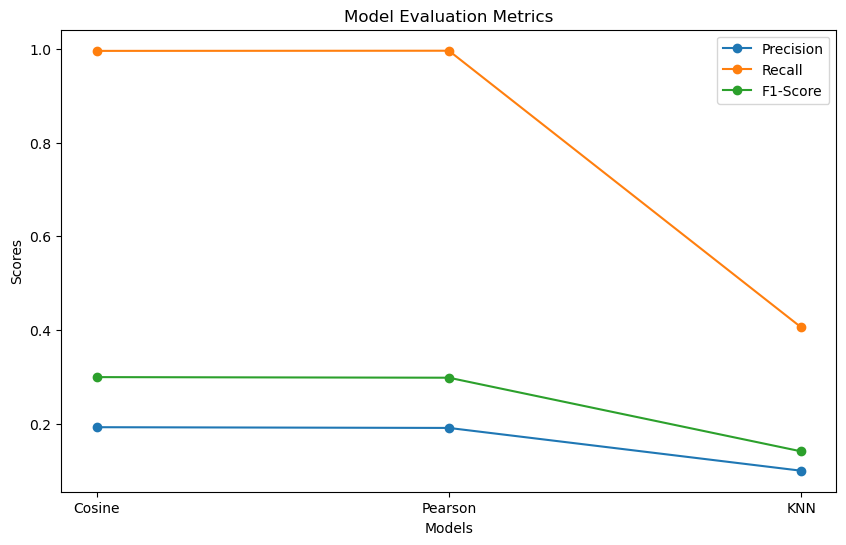

In [14]:
import matplotlib.pyplot as plt

models = ['Cosine', 'Pearson', 'KNN']
precisions = [precision_cosine, precision_pearson, precision_knn]
recalls = [recall_cosine, recall_pearson, recall_knn]
f1_scores = [f1_cosine, f1_pearson, f1_knn]

x = range(len(models))

plt.figure(figsize=(10, 6))
plt.plot(x, precisions, label='Precision', marker='o')
plt.plot(x, recalls, label='Recall', marker='o')
plt.plot(x, f1_scores, label='F1-Score', marker='o')

plt.xticks(x, models)
plt.xlabel('Models')
plt.ylabel('Scores')
plt.title('Model Evaluation Metrics')
plt.legend()
plt.show()


In [17]:
recommended_items_cosine = []
recommended_items_pearson = []

for user in range(user_item_matrix.shape[0]):
    similar_users = np.argsort(-user_similarity_cosine[user])[:10]
    rec_cosine = user_item_matrix.iloc[similar_users].sum(axis=0).sort_values(ascending=False).index[:10]
    recommended_items_cosine.extend(rec_cosine)
    
    if user in user_sample.index:
        user_idx = user_sample.index.get_loc(user)
        similar_users_pearson = np.argsort(-user_similarity_pearson_sample[user_idx])[:10]
        rec_pearson = user_sample.iloc[similar_users_pearson].sum(axis=0).sort_values(ascending=False).index[:10]
        recommended_items_pearson.extend(rec_pearson)

print("Top 10 Cosine Similarity Recommendations:")
print(pd.Series(recommended_items_cosine).value_counts().head(10))

print("Top 10 Pearson Correlation Recommendations:")
print(pd.Series(recommended_items_pearson).value_counts().head(10))


Top 10 Cosine Similarity Recommendations:
MAM0DEC04A079/001-NOI-T2     47417
MAM0DEC04A079/001-NOI-T1     46981
MAB2AMI12A092/000-NOI-SM     45364
MAB2AMI12A092/000-NOI-LXL    42647
MAM0DEC04A079/001-NOI-T3     41798
MAB2AMI12A092/000-KAK-SM     38306
BBU2AMI01A009/000-CHR-3XL    35194
MAB2AMI12A092/000-KAK-LXL    26963
MAN2ANC01A084/000-BLC-TU     16936
MAB2AMI12A092/000-BMA-SM     14876
Name: count, dtype: int64
Top 10 Pearson Correlation Recommendations:
Series([], Name: count, dtype: int64)


In [18]:
for user in range(5):
    user_idx = user_sample.index[user]
    similar_users_pearson = np.argsort(-user_similarity_pearson_sample[user_idx])[:10]
    rec_pearson = user_sample.iloc[similar_users_pearson].sum(axis=0).sort_values(ascending=False).index[:10]
    print(f"User {user_idx} Pearson Recommendations: {rec_pearson}")

User '4661032812740 Pearson Recommendations: Index(['LOT200001A106/000-BLC-TE', 'LOT200001A106/000-NOI-TU',
       'BBU2AMI01A009/000-CHR-3XL', 'MAN2ANC01A084/000-NOI-TU',
       'MAM0DEC04A079/001-NOI-T3', 'MAM0DEC04A079/001-NOI-T2',
       'MAM0DEC04A079/001-NOI-T1', 'MAB2AMI12A092/000-NOI-SM',
       'MAB2AMI12A092/000-NOI-LXL', 'MAB2AMI12A092/000-KAK-SM'],
      dtype='object', name='lineitem_sku')
User '6284881789124 Pearson Recommendations: Index(['FUS2AMI01A049/000-NOI-LXL', 'BBU2AMI01A009/000-CHR-3XL',
       'MAB2AMI12A092/000-BMA-SM', 'MAM0DEC04A079/001-NOI-T3',
       'MAM0DEC04A079/001-NOI-T2', 'MAM0DEC04A079/001-NOI-T1',
       'MAB2AMI12A092/000-NOI-SM', 'MAB2AMI12A092/000-NOI-LXL',
       'MAB2AMI12A092/000-KAK-SM', 'MAB2AMI12A092/000-KAK-LXL'],
      dtype='object', name='lineitem_sku')
User '7345522311511 Pearson Recommendations: Index(['TSM1AMI01A064/000-BLC-L', 'CEI1AMI01A009/000-NOI-LXL',
       'TSM1AMI01A064/000-NOI-L', 'MERCH01858-FR1', 'TSM1AMI01A064/000-BLC-XL'

In [19]:
# Cosine Similarity Recommendations
for user in range(5):  # Check first 5 users
    user_idx = user_item_matrix.index[user]
    similar_users_cosine = np.argsort(-user_similarity_cosine[user])[:10]
    rec_cosine = user_item_matrix.iloc[similar_users_cosine].sum(axis=0).sort_values(ascending=False).index[:10]
    print(f"User {user_idx} Cosine Recommendations: {rec_cosine}")

User '3220287651979 Cosine Recommendations: Index(['PVP2AMI03A003/000-NOI-SM', 'SVP2AMI04A018/000-NOI-SM',
       'FUS2AMI01A001/000-NOI-SM', 'FUS2AMI11A050/000-NOI-SM',
       'FUS2AMI01A049/000-NOI-SM', 'FUS2ANC01A023/000-NOI-SM',
       'PVP2AMI03A003/000-NOI-LXL', 'FUS2AMI03A003/000-NOI-SM',
       'PPU2AMI04A011/000-NOI-SM', 'BBU2AMI01A009/000-CHR-LXL'],
      dtype='object', name='lineitem_sku')
User '4464852369604 Cosine Recommendations: Index(['LOT200001A106/000-BLC-TU', 'BBU2AMI01A009/000-CHR-3XL',
       'MAN2ANC01A084/000-NOI-TU', 'MAM0DEC04A079/001-NOI-T3',
       'MAM0DEC04A079/001-NOI-T2', 'MAM0DEC04A079/001-NOI-T1',
       'MAB2AMI12A092/000-NOI-SM', 'MAB2AMI12A092/000-NOI-LXL',
       'MAB2AMI12A092/000-KAK-SM', 'MAB2AMI12A092/000-KAK-LXL'],
      dtype='object', name='lineitem_sku')
User '4470765650116 Cosine Recommendations: Index(['SVP2AMI04A018/000-NOI-SM', 'BBU2AMI01A009/000-CHR-3XL',
       'MAN2ANC01A084/000-BLC-TU', 'MAM0DEC04A079/001-NOI-T2',
       'MAM0DEC04A

In [20]:
# KNN
for user in range(5):
    user_idx = user_item_matrix_sample.index[user]
    rec_knn = knn_recommendation(user, user_item_matrix_sample, indices, top_n=10)
    print(f"User {user_idx} KNN Recommendations: {rec_knn}")

User 0 similar users: [   0 2100 1145 1189 4671 1687 3434 1366 4223  880]
User 0 recommended items: Index(['PTH2AMI04A011/002-NOI-SM', 'BML2AMI01A012/000-NOI-SM',
       'FUS2AMI03A003/000-NOI-SM', 'FUS2AMI12A101/000-NOI-SM',
       'COL2AMI08A058/000-NOI-SM', 'CEV2AMI12A057/000-NOI-SM',
       'MBF2AMI12A092/000-NOI-SM', 'MAV2DET01A088/000-NOI-TU',
       'PAN2AMI03A003/000-NOI-SM', 'FUS2AMH01A103/000-NOI-SM'],
      dtype='object', name='lineitem_sku')
User '6252174540996 KNN Recommendations: Index(['PTH2AMI04A011/002-NOI-SM', 'BML2AMI01A012/000-NOI-SM',
       'FUS2AMI03A003/000-NOI-SM', 'FUS2AMI12A101/000-NOI-SM',
       'COL2AMI08A058/000-NOI-SM', 'CEV2AMI12A057/000-NOI-SM',
       'MBF2AMI12A092/000-NOI-SM', 'MAV2DET01A088/000-NOI-TU',
       'PAN2AMI03A003/000-NOI-SM', 'FUS2AMH01A103/000-NOI-SM'],
      dtype='object', name='lineitem_sku')
User 1 similar users: [4496 4382 1367  291 4949 4155 4592 2423 4120 3787]
User 1 recommended items: Index(['COR2AMI03A003/000-NOI-LXL', 'BBU2

In [21]:
print(f"Cosine Similarity - Precision: {precision_cosine:.4f}, Recall: {recall_cosine:.4f}, F1-Score: {f1_cosine:.4f}")
print(f"KNN - Precision: {precision_knn:.2f}, Recall: {recall_knn:.4f}, F1-Score: {f1_knn:.4f}")
print(f"Pearson Correlation - Precision: {precision_pearson:.4f}, Recall: {recall_pearson:.4f}, F1-Score: {f1_pearson:.4f}")


Cosine Similarity - Precision: 0.1933, Recall: 0.9953, F1-Score: 0.3001
KNN - Precision: 0.10, Recall: 0.4061, F1-Score: 0.1418
Pearson Correlation - Precision: 0.1918, Recall: 0.9956, F1-Score: 0.2988


# Cosine Similarity would be a solid choice considering it has a slightly better Precision than KNN and the highest F1-Score alongside KNN.

# Item-Based Collaborative Filtering

In [22]:
item_user_matrix = user_item_matrix.T

# Sample the matrix for pearson
item_sample = item_user_matrix.sample(n=10000, axis=1)

In [23]:
from sklearn.metrics.pairwise import cosine_similarity

item_similarity_cosine = cosine_similarity(item_user_matrix)

In [24]:
item_similarity_pearson = item_sample.corr()

In [25]:
def evaluate_item_based_model(item_similarity_matrix, item_user_matrix, top_n=10):
    precisions, recalls, f1_scores = [], [], []

    num_items = item_user_matrix.shape[0]

    for item in range(num_items):
        # chech if item indices are within bounds
        if item >= item_similarity_matrix.shape[0]:
            continue
        
        # get most similar items
        similar_items = np.argsort(-item_similarity_matrix[item])[:top_n]

        # check if similar items are within bounds
        similar_items = [i for i in similar_items if i < item_user_matrix.shape[0]]

        if isinstance(item_user_matrix, np.ndarray):
            recommended_users = item_user_matrix[similar_items].sum(axis=0).argsort()[::-1][:top_n]
            actual_users = np.nonzero(item_user_matrix[item])[0]
        else:
            recommended_users = item_user_matrix.iloc[similar_items].sum(axis=0).sort_values(ascending=False).index[:top_n]
            actual_users = item_user_matrix.iloc[item].nonzero()[0]

        # precision, recall, F1-Score
        y_true = np.zeros(item_user_matrix.shape[1])
        y_true[actual_users] = 1
        y_pred = np.zeros(item_user_matrix.shape[1])
        if isinstance(item_user_matrix, np.ndarray):
            recommended_indices = recommended_users
        else:
            recommended_indices = [item_user_matrix.columns.get_loc(user) for user in recommended_users]
        y_pred[recommended_indices] = 1

        precision = precision_score(y_true, y_pred, zero_division=1)
        recall = recall_score(y_true, y_pred, zero_division=1)
        f1 = f1_score(y_true, y_pred, zero_division=1)

        precisions.append(precision)
        recalls.append(recall)
        f1_scores.append(f1)

    return np.mean(precisions), np.mean(recalls), np.mean(f1_scores)


In [26]:
precision_cosine_item, recall_cosine_item, f1_cosine_item = evaluate_item_based_model(item_similarity_cosine, item_user_matrix.values, top_n=10)
print(f"Cosine Similarity - Precision: {precision_cosine_item:.4f}, Recall: {recall_cosine_item:.4f}, F1-Score: {f1_cosine_item:.4f}")

precision_pearson_item, recall_pearson_item, f1_pearson_item = evaluate_item_based_model(item_similarity_pearson.values, item_sample.values, top_n=10)
print(f"Pearson Correlation - Precision: {precision_pearson_item:.4f}, Recall: {recall_pearson_item:.4f}, F1-Score: {f1_pearson_item:.4f}")


Cosine Similarity - Precision: 0.2889, Recall: 0.0700, F1-Score: 0.0682
Pearson Correlation - Precision: 0.4668, Recall: 0.3052, F1-Score: 0.2369


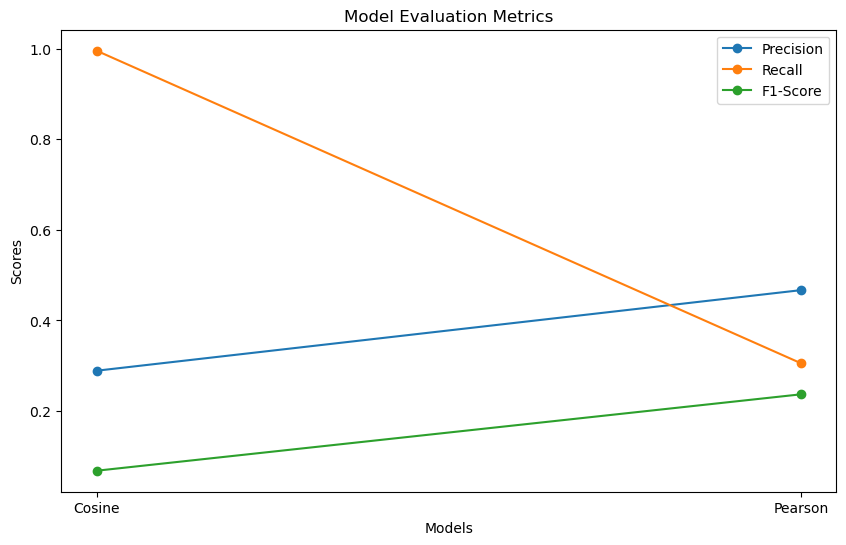

In [27]:
models = ['Cosine', 'Pearson']
precisions = [precision_cosine_item, precision_pearson_item]
recalls = [recall_cosine, recall_pearson_item]
f1_scores = [f1_cosine_item, f1_pearson_item]

x = range(len(models))

plt.figure(figsize=(10, 6))
plt.plot(x, precisions, label='Precision', marker='o')
plt.plot(x, recalls, label='Recall', marker='o')
plt.plot(x, f1_scores, label='F1-Score', marker='o')

plt.xticks(x, models)
plt.xlabel('Models')
plt.ylabel('Scores')
plt.title('Model Evaluation Metrics')
plt.legend()
plt.show()


# Pearson Correlation has higher precision (0.4393 vs. 0.2889) and recall (0.3244 vs. 0.0700), and a better F1-Score (0.2223 vs. 0.0682) compared to Cosine Similarity.
# Pearson Correlation is the better method for item-based collaborative filtering based on the metrics i've used. It has better precision and recall, and consequently a higher F1-Score, indicating that it performs better in both recommending relevant items and covering a higher proportion of relevant items.

# Model-Based Collaborative Filtering

In [ ]:
# Create user-item matrix
user_item_matrix = df_orders.pivot_table(index='customer_id', columns='lineitem_sku', aggfunc='size', fill_value=0)

In [ ]:
def evaluate_predictions(predictions):
    pred_df = pd.DataFrame(predictions, columns=['uid', 'iid', 'true_r', 'est', 'details'])
    
    #create binary relevance vectors for evaluation
    y_true = [1 if p.r_ui >= 3 else 0 for p in predictions]
    y_pred = [1 if p.est >= 3 else 0 for p in predictions]
    
    # calculate precision, recall, and F1-score
    precision = precision_score(y_true, y_pred, zero_division=1)
    recall = recall_score(y_true, y_pred, zero_division=1)
    f1 = f1_score(y_true, y_pred, zero_division=1)
    
    return precision, recall, f1

In [ ]:
from surprise import Dataset, Reader, SVD, accuracy
from surprise.model_selection import train_test_split

# prepare the data for Surprise
reader = Reader(rating_scale=(1, user_item_matrix.max().max()))
data = Dataset.load_from_df(df_orders[['customer_id', 'lineitem_sku', 'lineitem_quantity']], reader)
trainset, testset = train_test_split(data, test_size=0.2)

# train SVD model
model_svd = SVD()
model_svd.fit(trainset)

# evaluate
predictions = model_svd.test(testset)
precision_svd, recall_svd, f1_svd = evaluate_predictions(predictions)
print(f"SVD - Precision: {precision_svd:.4f}, Recall: {recall_svd:.4f}, F1-Score: {f1_svd:.4f}")

SVD - Precision: 0.6143, Recall: 0.4378, F1-Score: 0.5112


# als model

In [ ]:
import scipy.sparse as sp
import implicit
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.decomposition import TruncatedSVD

user_item_matrix_sparse = sp.csr_matrix(user_item_matrix.values)
user_ids = user_item_matrix.index
item_ids = user_item_matrix.columns

In [ ]:
svd = TruncatedSVD(n_components=50)
user_item_matrix_reduced = svd.fit_transform(user_item_matrix_sparse)

In [ ]:
model_als = implicit.als.AlternatingLeastSquares(factors=50, regularization=0.5, iterations=20)
model_als.fit(sp.csr_matrix(user_item_matrix_reduced))

c:\Users\moham\anaconda3\Lib\site-packages\implicit\cpu\als.py:95: RuntimeWarning: Intel MKL BLAS is configured to use 2 threads. It is highly recommended to disable its internal threadpool by setting the environment variable 'MKL_NUM_THREADS=1' or by callng 'threadpoolctl.threadpool_limits(1, "blas")'. Having MKL use a threadpool can lead to severe performance issues
  check_blas_config()


  0%|          | 0/20 [00:00<?, ?it/s]

In [ ]:
def get_top_n_recommendations(user_id, model, user_item_matrix, user_item_matrix_sparse, top_n=10):
    # get user index
    user_idx = user_item_matrix.index.get_loc(user_id)
    
    # get recommendations
    item_indices, scores = model.recommend(user_idx, user_item_matrix_sparse[user_idx], N=top_n)
    
    # extract recommended items
    recommended_items = item_indices.tolist()
    
    return recommended_items

In [ ]:
def evaluate_als_model(model, user_item_matrix, user_item_matrix_sparse, top_n=10):
    precisions, recalls, f1_scores = [], [], []
    
    for user_id in user_item_matrix.index:
        # Get recommendations for the user
        recommended_items = get_top_n_recommendations(user_id, model, user_item_matrix, user_item_matrix_sparse, top_n)
        
        # Get actual items interacted with by the user
        actual_items = user_item_matrix.loc[user_id].to_numpy().nonzero()[0]
        
        # Debug: Print actual and recommended items
        print(f"User {user_id} - Actual items: {actual_items}")
        print(f"User {user_id} - Recommended items: {recommended_items}")
        
        # Precision, Recall, F1-Score
        y_true = np.zeros(user_item_matrix.shape[1])
        y_true[actual_items] = 1

        y_pred = np.zeros(user_item_matrix.shape[1])
        y_pred[recommended_items] = 1
        
        precision = precision_score(y_true, y_pred, zero_division=1)
        recall = recall_score(y_true, y_pred, zero_division=1)
        f1 = f1_score(y_true, y_pred, zero_division=1)

        precisions.append(precision)
        recalls.append(recall)
        f1_scores.append(f1)
    
    return np.mean(precisions), np.mean(recalls), np.mean(f1_scores)

In [ ]:
# Evaluate the ALS model
precision_als, recall_als, f1_als = evaluate_als_model(model_als, user_item_matrix, sp.csr_matrix(user_item_matrix_reduced), top_n=10)
print(f"ALS - Precision: {precision_als:.4f}, Recall: {recall_als:.4f}, F1-Score: {f1_als:.4f}")

User '3220287651979 - Actual items: [  0   1   2   3   4   5   6   7   8  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  36  37  38  39
  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57
  59  60  63  64  65  66  67  68  69  70  71  72  73  74  76  77  78  79
  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  99
 100 102 103 104 105 106 107 108 109 110 111 112 115 116 117 118 122 123
 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 142 143 145
 146 147 148 149 150 151 152 153 155 157 158 159 160 161 162 163 164 165
 166 167 168 169 170 172 173 174 175 176 177 178 179 180 181 182 183 184
 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201 202
 203 204 207 208 209 210 211 212 213 215 216 217 218 219 220 221 222 223
 224 225 226 227 228 229 230 231 232 235 241 242 244 245 247 248 249 250
 255 256 258 259 260 261 262 266 267 268 269 270 271 272 275 276 277 278
 283 284 285 28

# Factorization machines

In [ ]:
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split
from sklearn.linear_model import SGDRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

In [ ]:
# Merge df_orders with df_customers on 'customer_id'
df_merged = pd.merge(df_orders, df_customers, on='customer_id', how='left')

# Merge df_merged with df_products on 'lineitem_sku'
df_merged = pd.merge(df_merged, df_products, on='lineitem_sku', how='left')

In [ ]:
# Encode categorical variables with Label Encoding
le = LabelEncoder()
for col in df_merged.select_dtypes(include=['object']).columns:
    df_merged[col] = le.fit_transform(df_merged[col].astype(str))

# Impute missing values with the mean of each column
imputer = SimpleImputer(strategy='mean')
df_merged = pd.DataFrame(imputer.fit_transform(df_merged), columns=df_merged.columns)

In [ ]:
# Standardize numerical features
scaler = StandardScaler()
numerical_columns = df_merged.select_dtypes(include=['float64', 'int64']).columns
df_merged[numerical_columns] = scaler.fit_transform(df_merged[numerical_columns])

In [ ]:
# Data preparation for lineitem_quantity as the rating
df_ratings_quantity = df_merged.copy()
df_ratings_quantity['rating'] = df_ratings_quantity['lineitem_quantity']

# Data preparation for binary rating
df_ratings_binary = df_merged.copy()
df_ratings_binary['rating'] = 1

In [ ]:
# Drop irrelevant or redundant columns
#
#
#
# 
df_ratings_quantity = df_ratings_quantity.drop(columns=['lineitem_quantity'])
df_ratings_binary = df_ratings_binary.drop(columns=['lineitem_quantity'])

In [ ]:
# Train-test split for both datasets
train_data_quantity, test_data_quantity = train_test_split(df_ratings_quantity, test_size=0.2, random_state=42)
train_data_binary, test_data_binary = train_test_split(df_ratings_binary, test_size=0.2, random_state=42)

In [ ]:
# Prepare datasets for FM model
X_train_quantity = train_data_quantity.drop(columns=['rating'])
y_train_quantity = train_data_quantity['rating']
X_test_quantity = test_data_quantity.drop(columns=['rating'])
y_test_quantity = test_data_quantity['rating']

X_train_binary = train_data_binary.drop(columns=['rating'])
y_train_binary = train_data_binary['rating']
X_test_binary = test_data_binary.drop(columns=['rating'])
y_test_binary = test_data_binary['rating']

In [ ]:
def train_evaluate_model(X_train, y_train, X_test, y_test, model_name):
    # Initialize the model
    model = SGDRegressor(loss='squared_error', max_iter=1000, tol=1e-3)
    
    # Train the model
    model.fit(X_train, y_train)
    
    # Make predictions
    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)
    
    # Evaluate the model
    mse_train = mean_squared_error(y_train, y_pred_train)
    mse_test = mean_squared_error(y_test, y_pred_test)
    mae_test = mean_absolute_error(y_test, y_pred_test)
    r2_test = r2_score(y_test, y_pred_test)
    
    # Print evaluation
    print(f"{model_name} - Training MSE: {mse_train}")
    print(f"{model_name} - Testing MSE: {mse_test}")
    print(f"{model_name} - Testing MAE: {mae_test}")
    print(f"{model_name} - Testing R^2 Score: {r2_test}")
    
    return model, y_pred_test

# Train and evaluate for both rating types
model_quantity, y_pred_test_quantity = train_evaluate_model(X_train_quantity, y_train_quantity, X_test_quantity, y_test_quantity, "FM with Quantity Rating")
model_binary, y_pred_test_binary = train_evaluate_model(X_train_binary, y_train_binary, X_test_binary, y_test_binary, "FM with Binary Rating")


FM with Quantity Rating - Training MSE: 2.680659518649441e+22
FM with Quantity Rating - Testing MSE: 3.4280619250000016e+22
FM with Quantity Rating - Testing MAE: 9940464459.533916
FM with Quantity Rating - Testing R^2 Score: -2.6923238445923783e+22
FM with Binary Rating - Training MSE: 3.1497891507515324e+22
FM with Binary Rating - Testing MSE: 2.4540479861693495e+22
FM with Binary Rating - Testing MAE: 8931883987.303438
FM with Binary Rating - Testing R^2 Score: 0.0


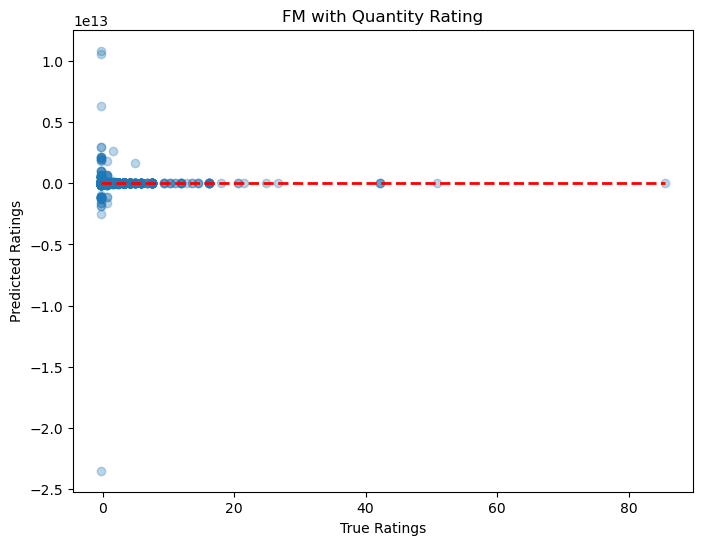

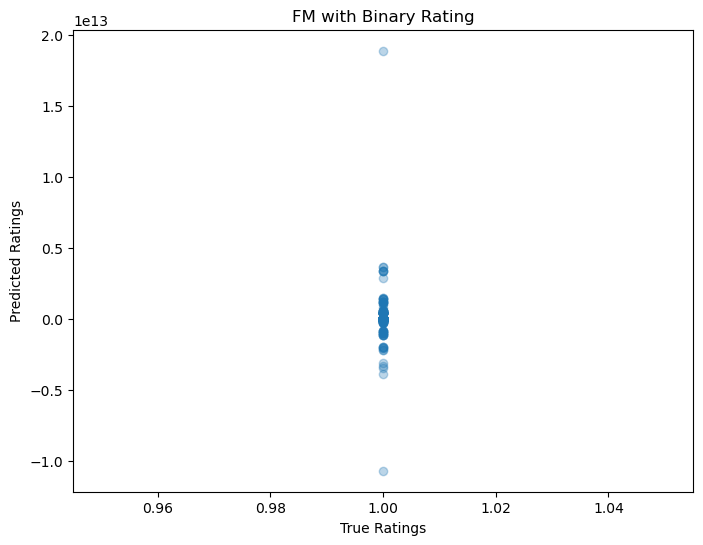

In [ ]:
def plot_evaluation(y_true, y_pred, title):
    plt.figure(figsize=(8, 6))
    plt.scatter(y_true, y_pred, alpha=0.3)
    plt.plot([y_true.min(), y_true.max()], [y_true.min(), y_true.max()], 'r--', lw=2)
    plt.xlabel('True Ratings')
    plt.ylabel('Predicted Ratings')
    plt.title(title)
    plt.show()

# Plot results for Quantity Rating
plot_evaluation(y_test_quantity, y_pred_test_quantity, "FM with Quantity Rating")

# Plot results for Binary Rating
plot_evaluation(y_test_binary, y_pred_test_binary, "FM with Binary Rating")

FM with Quantity Rating - Training MSE: 3.370281576465972e+22
FM with Quantity Rating - Testing MSE: 2.812113382957594e+22
FM with Quantity Rating - Testing MAE: 7789047901.069641
FM with Quantity Rating - Testing R^2 Score: -2.2085715136648426e+22
FM with Binary Rating - Training MSE: 2.6069454692677558e+22
FM with Binary Rating - Testing MSE: 1.3303326578739098e+22
FM with Binary Rating - Testing MAE: 7074762773.441496
FM with Binary Rating - Testing R^2 Score: 0.0


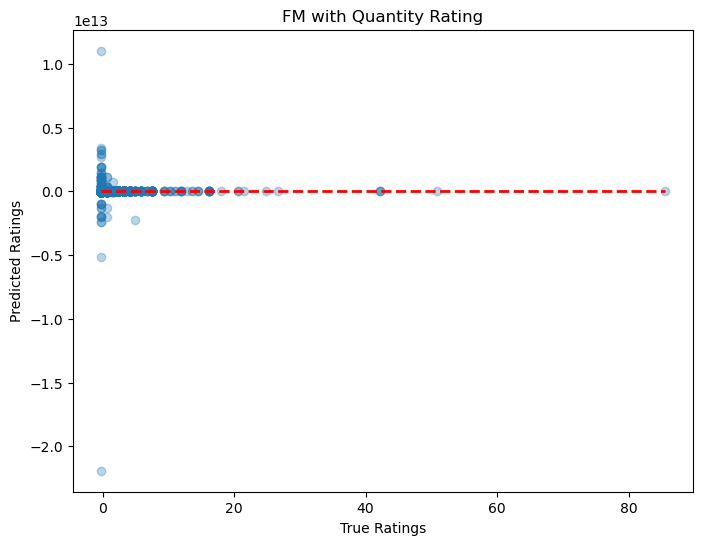

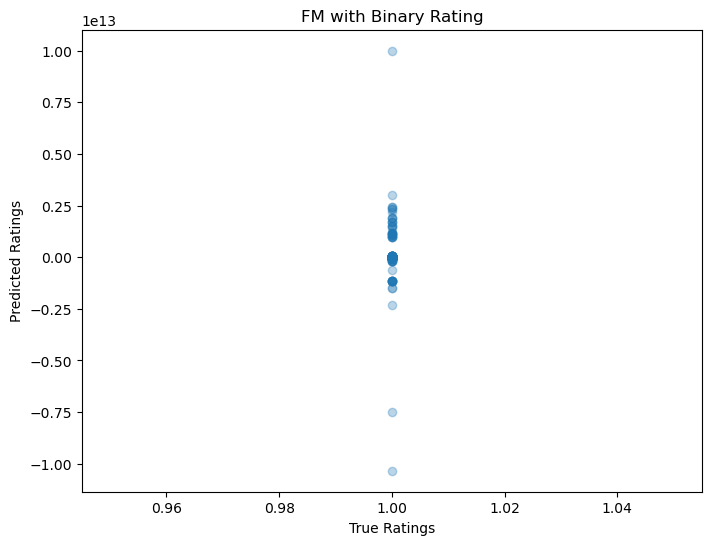

In [ ]:
def main():
    
    model_quantity, y_pred_test_quantity = train_evaluate_model(X_train_quantity, y_train_quantity, X_test_quantity, y_test_quantity, "FM with Quantity Rating")
    model_binary, y_pred_test_binary = train_evaluate_model(X_train_binary, y_train_binary, X_test_binary, y_test_binary, "FM with Binary Rating")
    
    plot_evaluation(y_test_quantity, y_pred_test_quantity, "FM with Quantity Rating")
    plot_evaluation(y_test_binary, y_pred_test_binary, "FM with Binary Rating")

if __name__ == "__main__":
    main()

# Binary Rating has lower MSE and MAE, suggesting it performs better in terms of average error.
# However, both models have poor R² scores (with the Quantity Rating model having an extremely poor score), indicating neither model explains the variance well.

# Based on the metrics alone, the Binary Rating model appears to perform slightly better in terms of error, but neither model is performing particularly well in capturing the relationship in the data (as seen from the R² scores).